## Auswertung Geopandas und klassisch von Kanton und Stadt
Herleitung und Versuche unter:
- **20 Kanton Auswertung Geopandas**
- **22 Stadt Zug Endprodukt Auswertung**
- **21 Stadt Zug Auswertung Geopandas**

In [1]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString
%matplotlib inline
import matplotlib.pyplot as plt
import contextily as ctx # Für Hintergrundkarte
folderpath=r"C:\Users\Zoe\Desktop\maz-datenjournalismus\Daten_BR_Handelsreg"
folderpath_geo=r"C:\Users\Zoe\Desktop\maz-datenjournalismus\Geodaten"

Auf windows funktioniert die Instellation von contextil am besten via conda-Befehl. (anders gehts nicht)
- conda install contextily --channel conda-forge


# 1. Laden der Karte der Gemeinden 
Hier gefunden:
https://www.bfs.admin.ch/bfs/de/home/dienstleistungen/geostat/geodaten-bundesstatistik/administrative-grenzen/generalisierte-gemeindegrenzen.html


In [2]:
gdf_gemeinden = gpd.read_file(folderpath_geo+'/ggg_2019-LV95/shp/g1a19.shp')

In [3]:
gdf_zg=gdf_gemeinden[gdf_gemeinden["AName"]=="Zug"]

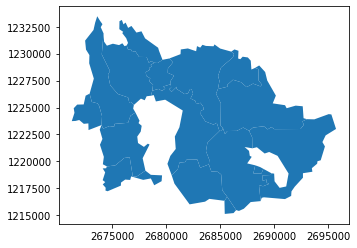

In [4]:
gdf_zg.plot()

## 1.1 Stadt Zug rausfiltern

In [5]:
gdf_stadtzug=gdf_zg[gdf_zg["GMDNAME"]=="Zug"]

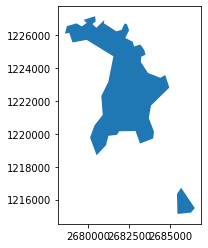

In [6]:
gdf_stadtzug.plot()

# File mit den HR-Daten 


In [7]:
df_sauber=pd.read_csv(folderpath+"/BRFrames/Kanton_ganz_mit_Vergleichswert")

In [8]:
dfhr=df_sauber[["Adresse", "Firmen","Telbuch","Vergleich", "GDENAME", "GKODE","GKODN"]]

In [9]:
dfhr.dtypes

Adresse       object
Firmen         int64
Telbuch        int64
Vergleich    float64
GDENAME       object
GKODE        float64
GKODN        float64
dtype: object

In [10]:
# Nun nur jene Adressen rausfiltern, an welchen Firmen ansässig sind
dfhr_pl=dfhr[dfhr["Firmen"]>0]

In [11]:
# Noch eine Spalte kreieren mit der Wurzel aus der Anzahl Firmen (kann so evtl besser dargestellt werden)
dfhr_pl["Wurzelwert"]=dfhr_pl["Firmen"]**(1/2)

C:\Users\Zoe\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [12]:
dfhr_pl

,Adresse,Firmen,Telbuch,Vergleich,GDENAME,GKODE,GKODN,Wurzelwert
0,"Zugerstrasse 74, Baar",164,12,13.666667,Baar,2681933.977,1226416.568,12.806248
1,"Mühlegasse 18, Baar",92,57,1.614035,Baar,2682425.299,1228159.836,9.591663
2,"Blegistrasse 11b, Baar",88,13,6.769231,Baar,2685739.840,1230044.629,9.380832
3,"Sihlbruggstrasse 105, Baar",80,39,2.051282,Baar,2684903.579,1229684.742,8.944272
4,"Ruessenstrasse 12, Baar",75,16,4.687500,Baar,2685107.750,1229580.996,8.660254
...,...,...,...,...,...,...,...,...
6968,"Chamerstrasse 45, Zug",2,5,0.400000,Zug,2680878.372,1225294.140,1.414214
6970,"Chamerstrasse 47, Zug",1,4,0.250000,Zug,2680840.404,1225315.633,1.000000
6973,"Chamerstrasse 50, Zug",15,12,1.250000,Zug,2680869.425,1225328.661,3.872983
6976,"Chamerstrasse 52, Zug",11,5,2.200000,Zug,2680846.193,1225345.734,3.316625


In [13]:
# Kreieren der Angabe der Geometrie. Mit Hilfe der Gemeindekoordinaten.
dfhr_pl['Punkt'] = dfhr_pl.apply(lambda row: Point(row["GKODE"], row["GKODN"]), axis=1)

C:\Users\Zoe\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [14]:
gdf_hr=gpd.GeoDataFrame(dfhr_pl, geometry="Punkt")

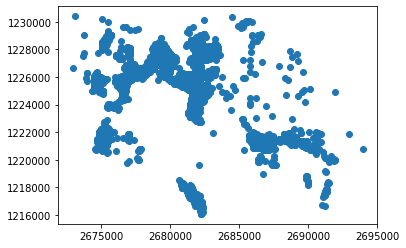

In [15]:
gdf_hr.plot()# es funktioniert

Text(0.5, 1, 'Firmensitze im Kanton Zug')

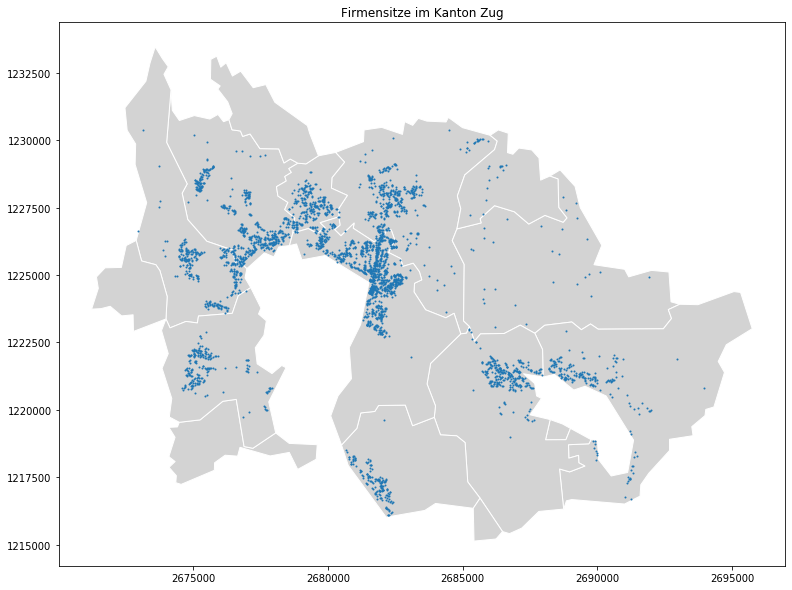

In [16]:
ax = gdf_zg.plot(figsize=(14,10), color='lightgrey', edgecolor='white')
gdf_hr.plot(figsize=(14,10), markersize=1,ax=ax)
ax.set_title("Firmensitze im Kanton Zug")

### Punkte in unterschiedlicher Grösse

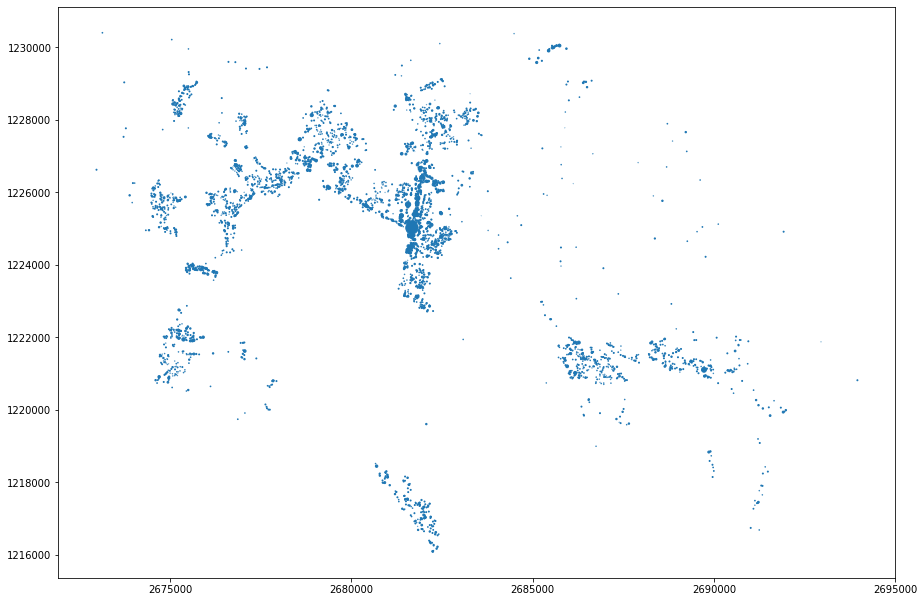

In [17]:
gdf_hr.plot(markersize=gdf_hr['Vergleich'], figsize=(15,20))

Text(0.5, 1, 'Firmensitze in der Stadt Zug')

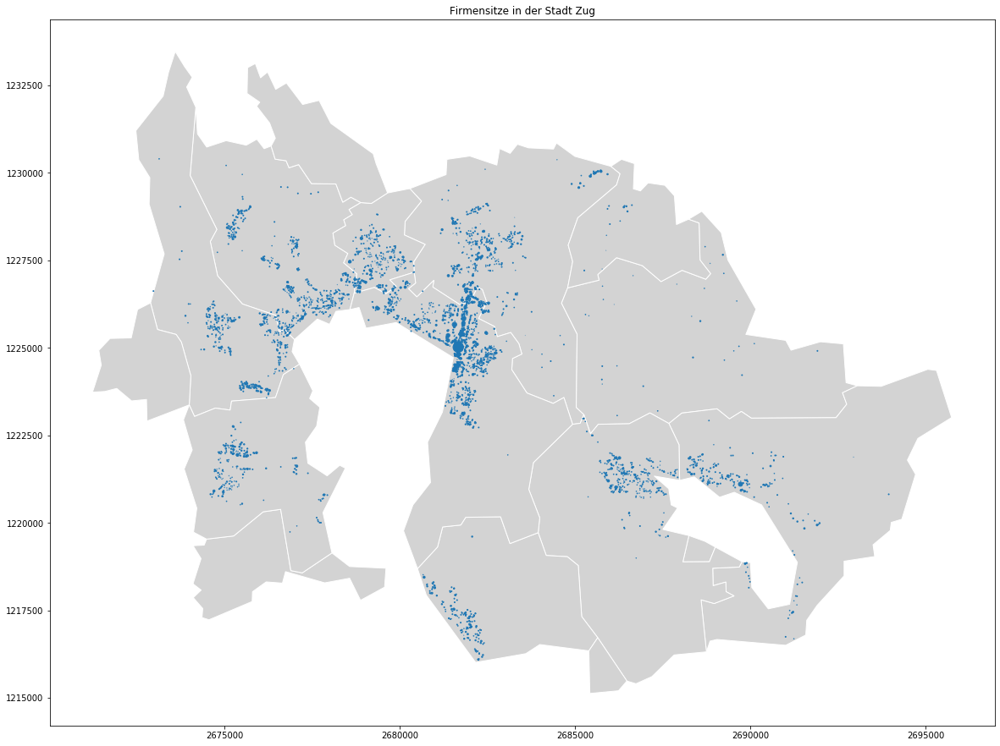

In [18]:
ax = gdf_zg.plot(figsize=(20,25), color='lightgrey', edgecolor='white')
gdf_hr.plot(figsize=(20,25), markersize=gdf_hr['Vergleich'], ax=ax)
ax.set_title("Firmensitze in der Stadt Zug")

#### Wie bringe ich die Punkte zusammen mit der Karte hin
Ich muss zuerst dem gdf_hr ein crs-Format geben. Danach in das Merkator-Format umwandeln.

In [19]:
gdf_stadtzug_es=gdf_stadtzug.to_crs(epsg=3857)#umwalndeln in Merkator
gdf_zg_es=gdf_zg.to_crs(epsg=3857) #umwalndeln in Merkator
gdf_hr.crs=({'init' :'epsg:2056'}) #Zuerst crs. geben
gdf_hr_es=gdf_hr.to_crs(epsg=3857)# umwandeln in Merkator

In [20]:
gdf_zg.crs

{'init': 'epsg:2056'}

In [21]:
gdf_zg_es.crs 

{'init': 'epsg:3857', 'no_defs': True}

In [22]:
gdf_hr.crs

{'init': 'epsg:2056'}

In [23]:
gdf_hr_es.crs

{'init': 'epsg:3857', 'no_defs': True}

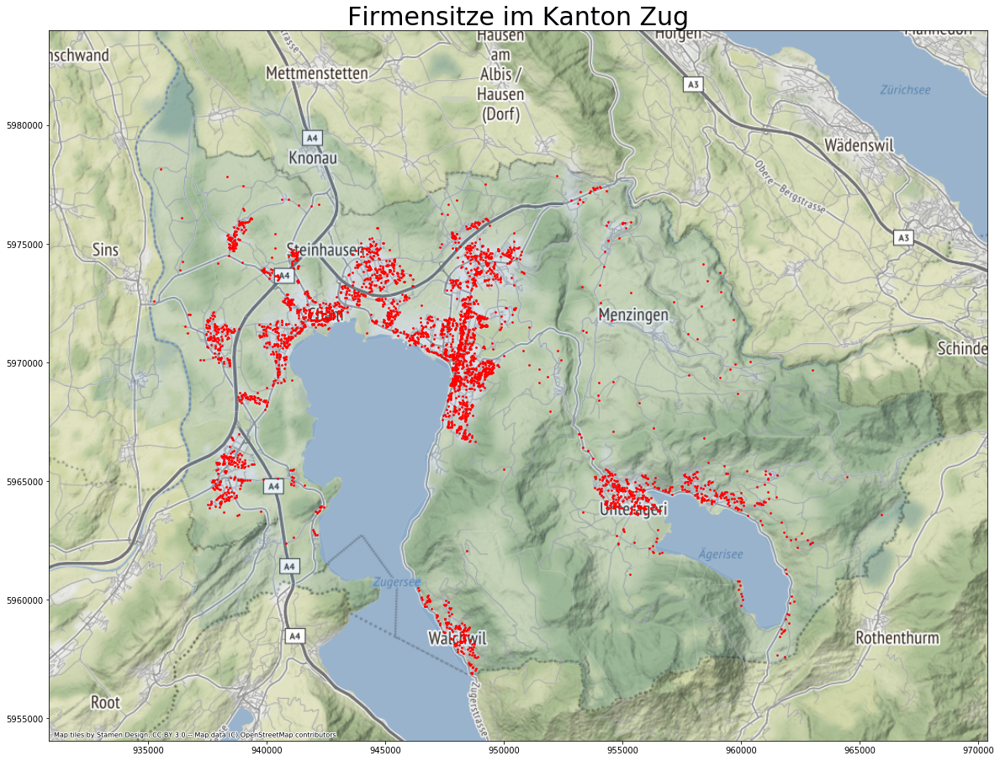

In [24]:
ax = gdf_zg_es.plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=3,color="red", ax=ax)
ax.set_title("Firmensitze im Kanton Zug",fontsize=30)
ctx.add_basemap(ax)

# Die PUnkte kommen einfach nicht mehr... 
#https://gis.stackexchange.com/questions/283677/geometry-data-in-geodataframe-will-not-plot (vielleicht da was)

# Hier mit der Grösse der Firmen
Je mehr Firmen desto grösser der Punkt

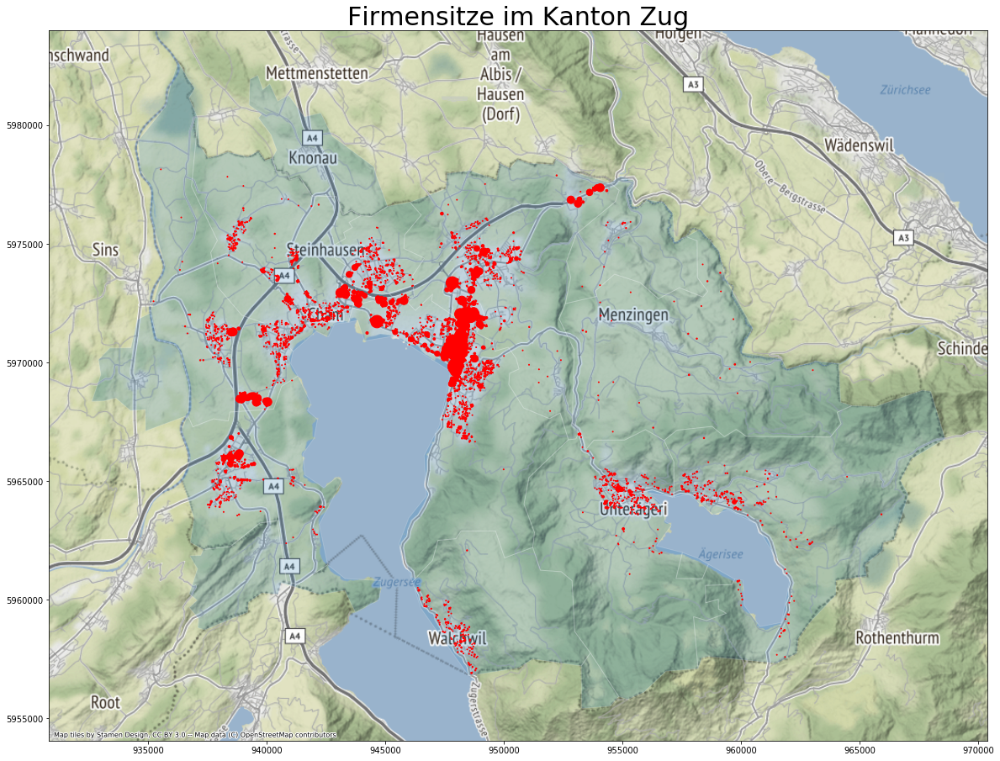

In [25]:
ax = gdf_zg_es.plot(figsize=(20,25), alpha=0.2, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=gdf_hr['Firmen'],color="red", ax=ax)
ax.set_title("Firmensitze im Kanton Zug",fontsize=30)
ctx.add_basemap(ax)


# Hier mit dem Vergleichswert 
Die Stadt Zug kristallisiert sich heraus - die anderen Hubs werden kleiner 

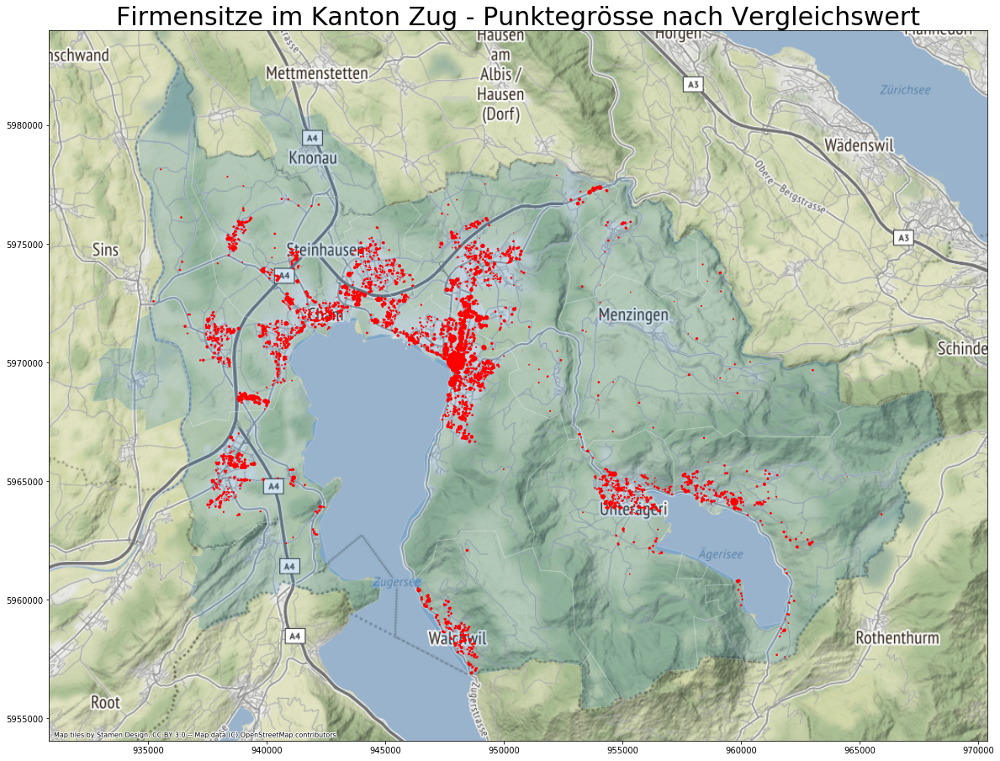

In [26]:
ax = gdf_zg_es.plot(figsize=(20,25), alpha=0.2, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=gdf_hr_es['Vergleich']*3,color="red", ax=ax)
ax.set_title("Firmensitze im Kanton Zug - Punktegrösse nach Vergleichswert", fontsize=30)
ctx.add_basemap(ax)

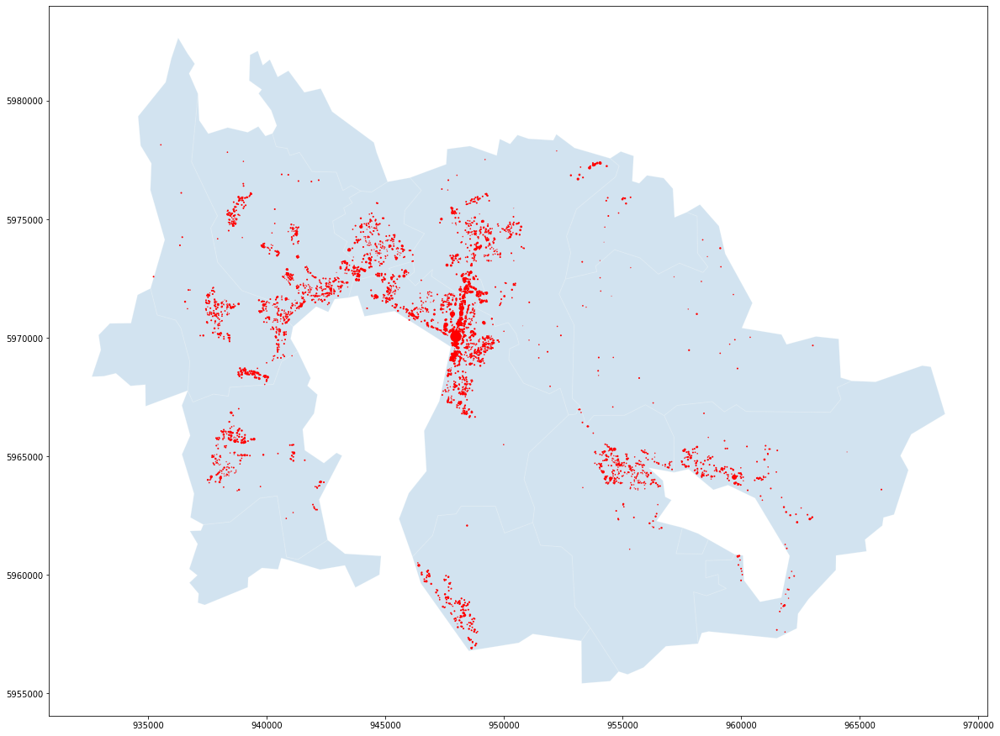

In [27]:
ax = gdf_zg_es.plot(figsize=(20,25), alpha=0.2, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=gdf_hr['Vergleich'],color="red", ax=ax)
#ax.set_title("Firmensitze in der Stadt Zug")
#ctx.add_basemap(ax)

In [28]:
gdf_hr_es[(gdf_hr_es["Firmen"]>20)&(gdf_hr_es["Vergleich"]>8)].sort_values("Vergleich", ascending=False).head(50)

,Adresse,Firmen,Telbuch,Vergleich,GDENAME,GKODE,GKODN,Wurzelwert,Punkt
6114,"Baarerstrasse 11.2, Zug",152,1,152.000000,Zug,2681667.000,1225021.000,12.328828,POINT (947981.707 5970048.185)
2408,"Dammstrasse 21, Zug",28,1,28.000000,Zug,2681559.203,1225668.139,5.291503,POINT (947836.468 5971003.494)
209,"Gulmstrasse 35, Oberägeri",24,1,24.000000,Oberägeri,2689721.402,1221106.711,4.898979,POINT (959720.213 5964114.614)
2917,"Grafenauweg 10, Zug",99,6,16.500000,Zug,2681379.419,1225358.758,9.949874,POINT (947566.268 5970551.440)
0,"Zugerstrasse 74, Baar",164,12,13.666667,Baar,2681933.977,1226416.568,12.806248,POINT (948401.905 5972098.350)
1923,"Sinserstrasse 65, Cham",59,5,11.800000,Cham,2676816.343,1226744.724,7.681146,POINT (940892.652 5972682.392)
6496,"Bahnhofstrasse 17, Zug",23,2,11.500000,Zug,2681655.495,1224835.088,4.795832,POINT (947961.069 5969774.619)
6500,"Bahnhofstrasse 20, Zug",148,13,11.384615,Zug,2681670.837,1224832.538,12.165525,POINT (947983.542 5969770.553)
2974,"Gubelstrasse 11, Zug",149,14,10.642857,Zug,2681806.782,1225375.926,12.206556,POINT (948194.099 5970568.092)
1317,"Hinterbergstrasse 49, Steinhausen",53,5,10.600000,Steinhausen,2678573.467,1227464.597,7.280110,POINT (943487.200 5973709.159)


### Mehr als 20 Firmen und höheren Vergleichswert als 6

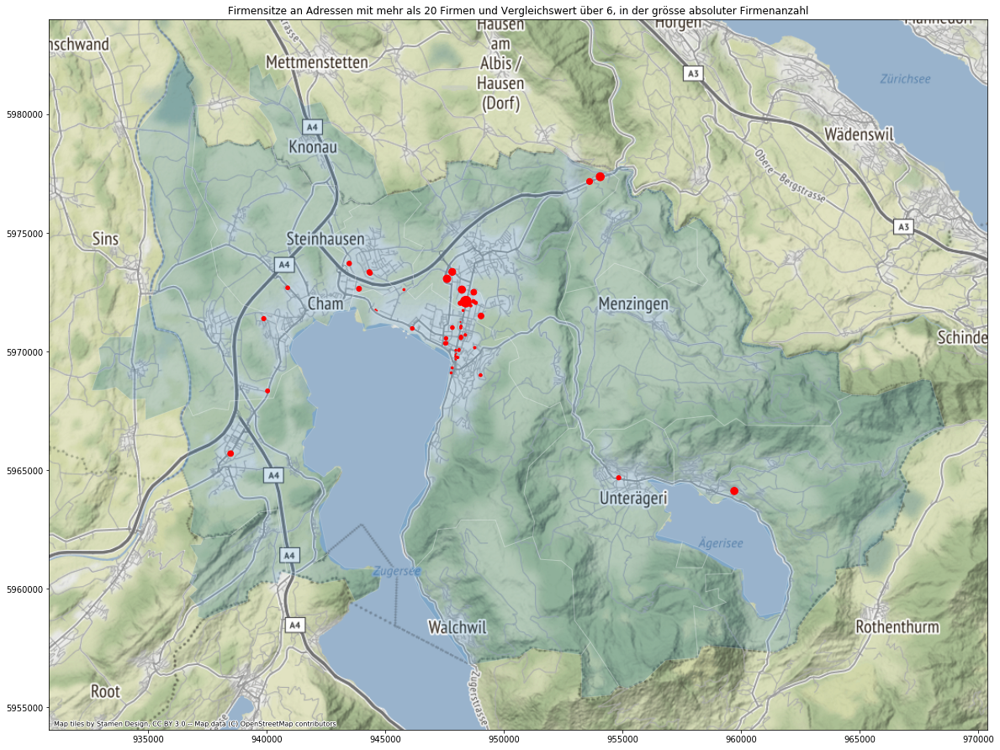

In [29]:
ax = gdf_zg_es.plot(figsize=(20,25), alpha=0.2, edgecolor='white')
gdf_hr_es[(gdf_hr_es["Firmen"]>20)&(gdf_hr_es["Vergleich"]>5)].plot(figsize=(20,25), markersize=gdf_hr['Firmen'],color="red", ax=ax)
ax.set_title("Firmensitze an Adressen mit mehr als 20 Firmen und Vergleichswert über 6, in der grösse absoluter Firmenanzahl")
ctx.add_basemap(ax)

### Fokus auf Zug wobei auch die anderen reinkommen

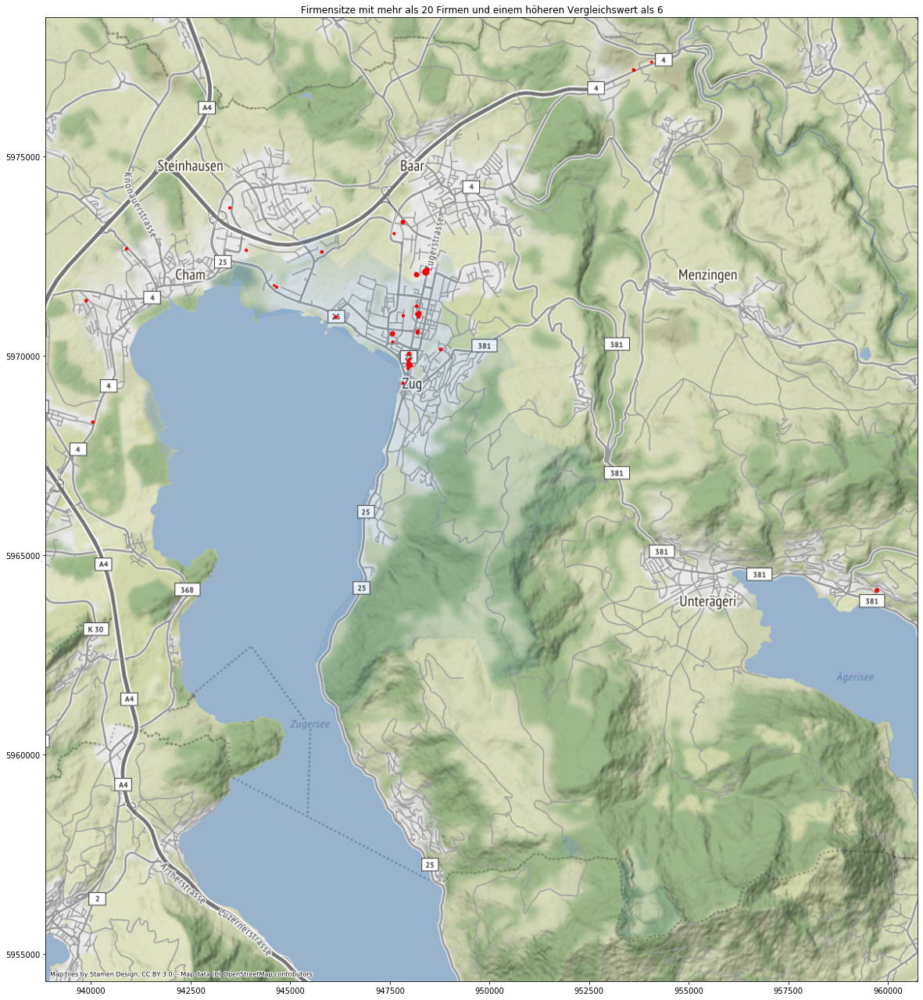

In [30]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es[(gdf_hr_es["Firmen"]>20)&(gdf_hr_es["Vergleich"]>6)].plot(figsize=(20,25), markersize=gdf_hr['Vergleich']*5,color="red", ax=ax)
ax.set_title("Firmensitze mit mehr als 20 Firmen und einem höheren Vergleichswert als 6")
ctx.add_basemap(ax)

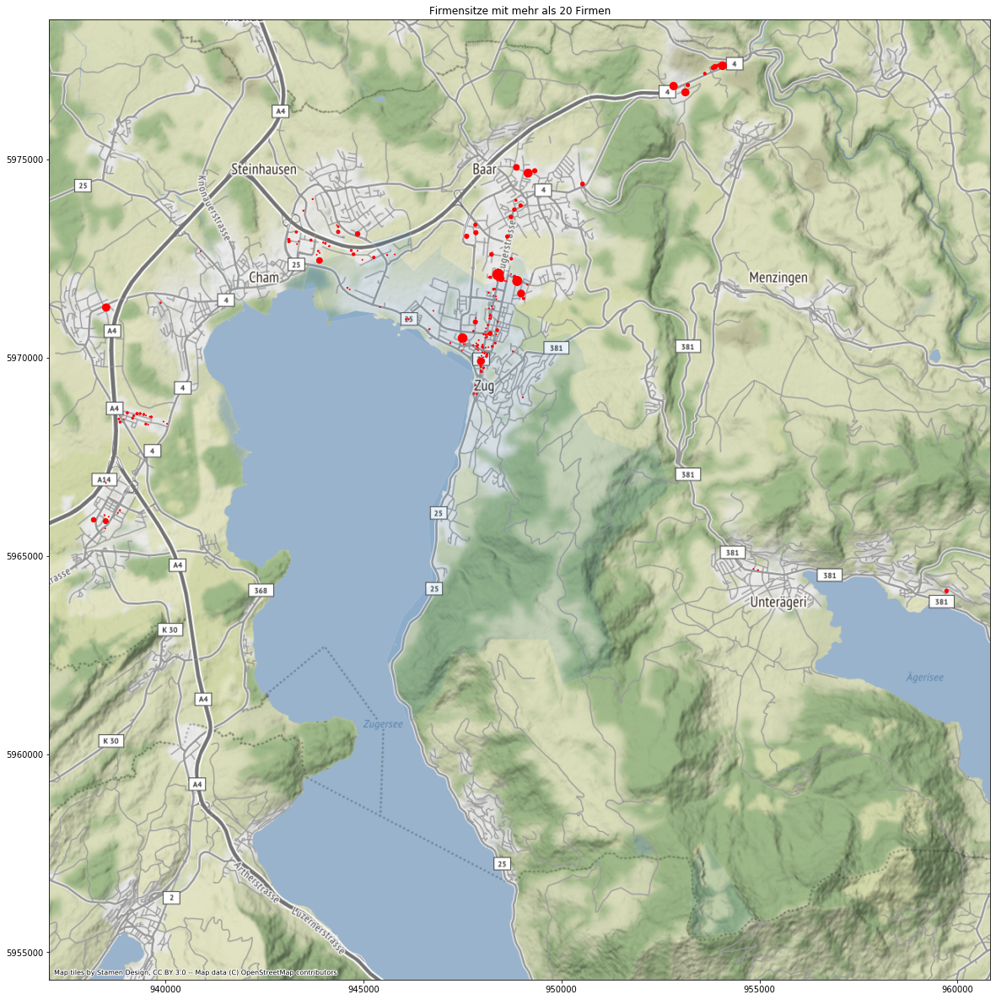

In [31]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es[(gdf_hr_es["Firmen"]>20)].plot(figsize=(20,25), markersize=gdf_hr['Firmen'],color="red", ax=ax)
ax.set_title("Firmensitze mit mehr als 20 Firmen")
ctx.add_basemap(ax)

#### Alle Firmen leicht verschwommen um Ansammlungen besser zu erkennen

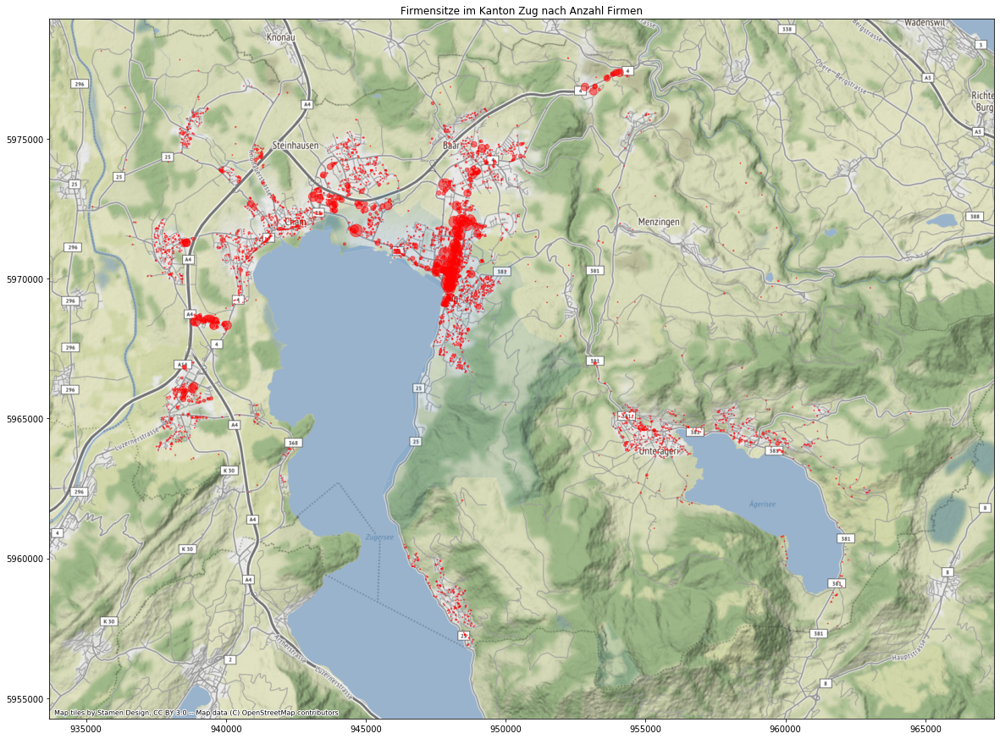

In [32]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=gdf_hr_es['Firmen'],color="red",alpha=0.5, ax=ax)
ax.set_title("Firmensitze im Kanton Zug nach Anzahl Firmen")
ctx.add_basemap(ax)

(945000, 950000)

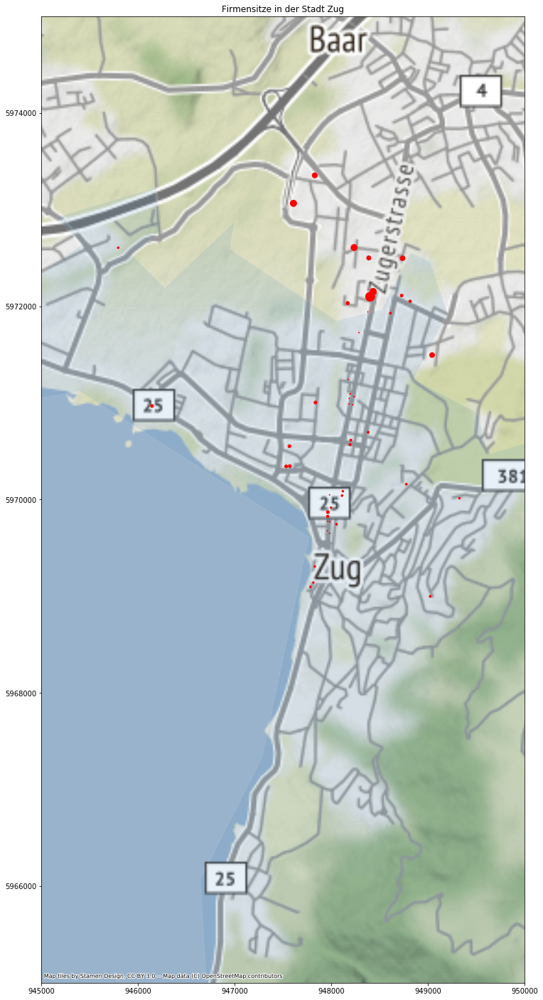

In [33]:
ax = gdf_stadtzug_es[gdf_stadtzug_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es[(gdf_hr_es["Firmen"]>15)&(gdf_hr_es["Vergleich"]>5)].plot(figsize=(20,25), markersize=gdf_hr_es['Firmen'],color="red", ax=ax)
ax.set_title("Firmensitze in der Stadt Zug")
ctx.add_basemap(ax)
ax.set_ylim([5965000,5975000])
ax.set_xlim([945000, 950000])

(945000, 950000)

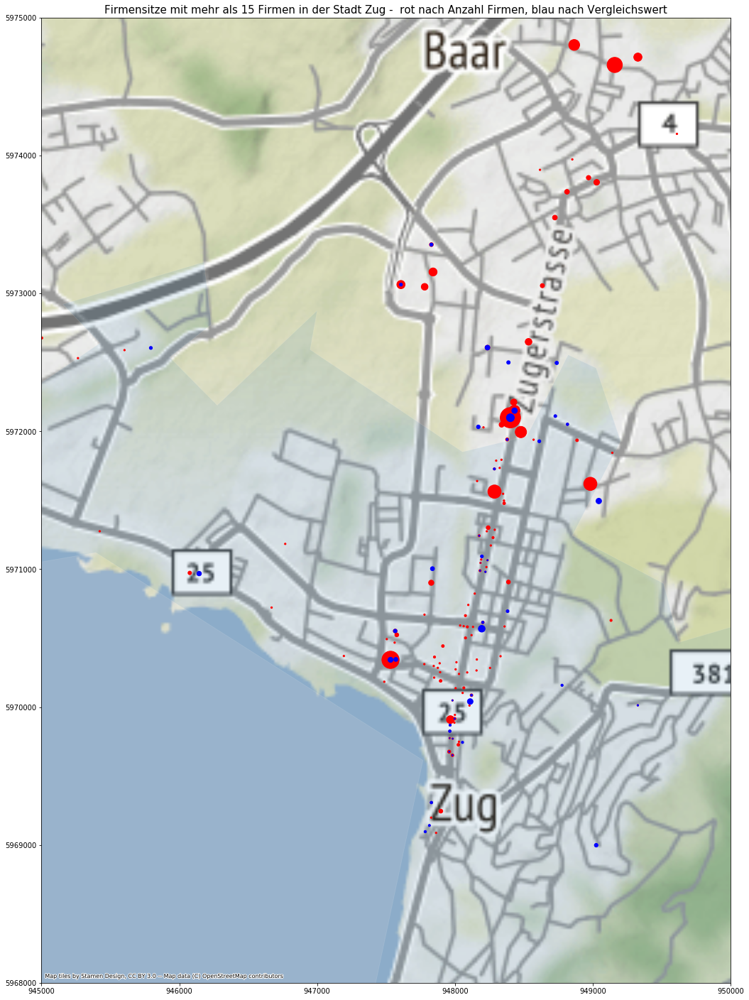

In [38]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es[(gdf_hr_es["Firmen"]>15)].plot(figsize=(20,25), markersize=gdf_hr_es['Firmen']*5,color="red", ax=ax)
gdf_hr_es[(gdf_hr_es["Firmen"]>15)&(gdf_hr_es["Vergleich"]>5)].plot(figsize=(20,25), markersize=gdf_hr_es['Vergleich']*9,color="blue",alpha=1, ax=ax)
ax.set_title("Firmensitze mit mehr als 15 Firmen in der Stadt Zug -  rot nach Anzahl Firmen, blau nach Vergleichswert", fontsize=15)
ctx.add_basemap(ax)
ax.set_ylim([5968000,5975000])
ax.set_xlim([945000, 950000])

(945000, 950000)

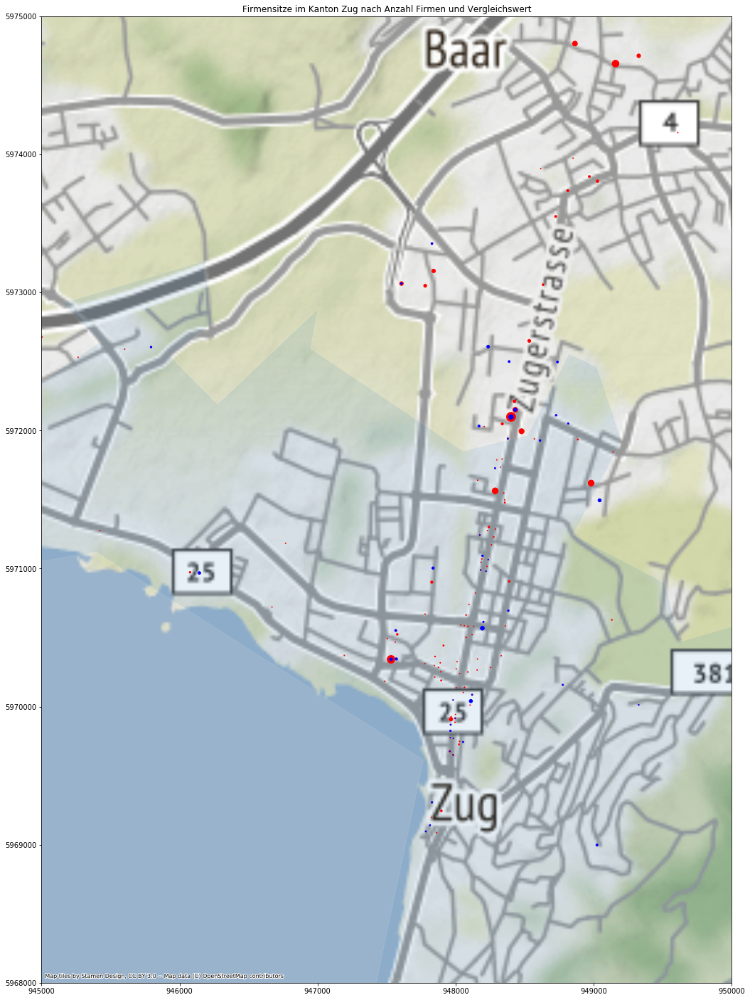

In [35]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es[(gdf_hr_es["Firmen"]>15)].plot(figsize=(20,25), markersize=gdf_hr_es['Firmen'],color="red",alpha=1, ax=ax)
gdf_hr_es[(gdf_hr_es["Firmen"]>15)&(gdf_hr_es["Vergleich"]>5)].plot(figsize=(20,25), markersize=gdf_hr_es['Vergleich']*3,color="blue",alpha=1, ax=ax)
ax.set_title("Firmensitze im Kanton Zug nach Anzahl Firmen und Vergleichswert")
ctx.add_basemap(ax)
ax.set_ylim([5968000,5975000])
ax.set_xlim([945000, 950000])

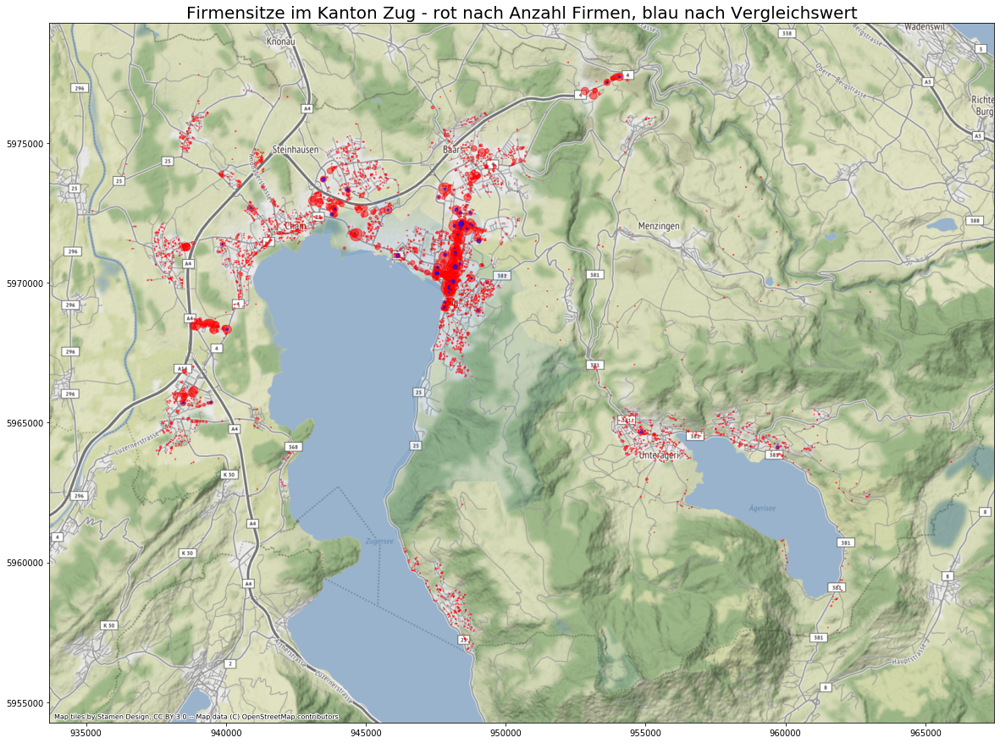

In [36]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=gdf_hr_es['Firmen'],color="red",alpha=0.5, ax=ax)
gdf_hr_es[(gdf_hr_es["Firmen"]>15)&(gdf_hr_es["Vergleich"]>5)].plot(figsize=(20,25), markersize=gdf_hr_es['Vergleich']*3,color="blue",alpha=0.5, ax=ax)
ax.set_title("Firmensitze im Kanton Zug - rot nach Anzahl Firmen, blau nach Vergleichswert", fontsize=20)
ctx.add_basemap(ax)

# Gemeinden anschauen
Wo ist der höchste Vergleichswert? Welche Gemeinde hat am meisten Firmen.

In [37]:
(column='gdp_per_cap')

SyntaxError: invalid syntax (<ipython-input-37-a91cd65107ce>, line 1)

In [ ]:
ax = gdf_zg_es[gdf_zg_es["GMDNAME"]=="Zug"].plot(figsize=(20,25), alpha=0.1, edgecolor='white')
gdf_hr_es.plot(figsize=(20,25), markersize=gdf_hr_es['Firmen'],color="red",alpha=0.5, ax=ax)
gdf_hr_es[(gdf_hr_es["Firmen"]>15)&(gdf_hr_es["Vergleich"]>5)].plot(figsize=(20,25), markersize=gdf_hr_es['Vergleich']*3,color="blue",alpha=0.5, ax=ax, )
ax.set_title("Firmensitze im Kanton Zug nach Anzahl Firmen")
ctx.add_basemap(ax)
